In [1]:
import json
import os
import pandas as pd
from io import BytesIO ## 
import matplotlib.pyplot as plt
import cv2
import random
from PIL import Image ## 분석할 이미지

In [2]:
## open_image test
dir_path = "../../disk/Data/open_image/"
#dir_path = "../Data/train2017/"
#dir_path = "../../disk/Data/flickr30k_images/"


non_names = []
for folder, subfolders, filenames in os.walk(dir_path):
    for img in filenames:
        non_names.append(folder+'/'+img)
random.shuffle(non_names)
non_disaster_images = non_names
print(len(non_disaster_images))

1742706


In [3]:
## open_image test
trn_dir_path = "../Data/disaster/train/origin_images/open_image_disaster"
tst_dir_path = "../Data/disaster/test/origin_images/open_image_disaster"

dis_names = []
for folder, subfolders, filenames in os.walk(trn_dir_path):
    for img in filenames:
        dis_names.append(folder+'/'+img)
        
for folder, subfolders, filenames in os.walk(tst_dir_path):
    for img in filenames:
        dis_names.append(folder+'/'+img)
        
disaster_images = dis_names
print(len(disaster_images))

335


In [4]:
image_data = non_disaster_images + disaster_images

In [5]:
non_label = [0]*int(len(non_disaster_images))
dis_label = [1]*int(len(disaster_images))
image_label = non_label + dis_label

In [6]:
tst_df2 = pd.DataFrame(image_data, columns=['image_id'])
tst_df2['dir'] = tst_df2['image_id'].apply(lambda x: os.path.dirname(x))
tst_df2['image_id'] = tst_df2['image_id'].apply(lambda x: os.path.basename(x))
tst_df2['label'] = image_label
test = tst_df2
test

,image_id,dir,label
0,3adcfd8dfce85042.jpg,../../disk/Data/open_image/train_3,0
1,fde30dd94530ae14.jpg,../../disk/Data/open_image/train_f,0
2,64ecc7c5f98d7b66.jpg,../../disk/Data/open_image/train_6,0
3,ad1bf082e0868e6d.jpg,../../disk/Data/open_image/train_a,0
4,8a22cc98a78741b8.jpg,../../disk/Data/open_image/train_8,0
...,...,...,...
1743036,75719757c412f287.jpg,../Data/disaster/test/origin_images/open_image...,1
1743037,54703d04c4271a5a.jpg,../Data/disaster/test/origin_images/open_image...,1
1743038,1df5638d77ff56cb.jpg,../Data/disaster/test/origin_images/open_image...,1
1743039,a8271e8c2fa02700.jpg,../Data/disaster/test/origin_images/open_image...,1


In [12]:
dist.destroy_process_group()

In [7]:
model_name = 'inception_resnet_v2'
model_dir = model_name + '/inception_resnet_v2_6010'
%run eval_test.ipynb

100%|██████████████████████████████████| 13618/13618 [35:14:04<00:00,  9.31s/it]


In [9]:
print(f'accuracy: {test_acc:.4f}')
print(f'f1_score: {epoch_f1:.4f}')
print(f'confusion_matrix \n-------------------------\n {test_matrix}')

accuracy: 0.9924
f1_score: 0.5214
confusion_matrix 
-------------------------
 [[1729449   13257]
 [     11     324]]


In [11]:
test.to_csv('test_result/nsb2_flk_tst3.csv', index=False)

In [17]:
non_matched_idx = test['label'] != test['pred']
non_matched = test[non_matched_idx].reset_index(inplace = False, drop=True)
non_matched

,image_id,dir,label,pred,confidence score
0,1c70ab572c686320.jpg,../../disk/Data/open_image/train_1,0,1,0.507919
1,128b557c21a0a156.jpg,../../disk/Data/open_image/train_1,0,1,0.724059
2,1ca6c2563cb29056.jpg,../../disk/Data/open_image/train_1,0,1,0.532085
3,136183fe20da87eb.jpg,../../disk/Data/open_image/train_1,0,1,0.531901
4,1b4e3b9f8b580313.jpg,../../disk/Data/open_image/train_1,0,1,0.560463
...,...,...,...,...,...
305,58d12e852edf194f.jpg,../Data/disaster_images/open_image_disaster,1,0,0.578020
306,35242c3f7a36c7bb.jpg,../Data/disaster_images/open_image_disaster,1,0,0.776405
307,76de10f902cfddf4.jpg,../Data/disaster_images/open_image_disaster,1,0,0.590320
308,7e8eb56044f4b6fd.jpg,../Data/disaster_images/open_image_disaster,1,0,0.500482


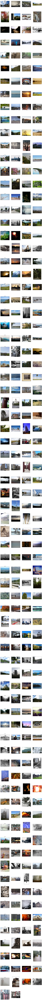

In [18]:
## show img status

back = 0
plt.figure(figsize=(16,500))
for i in range(len(non_matched[back:])):
    plt.subplot(100,4,i+1)
    if i % 4 == 0:
        plt.title(f"{(i+1+back)/4}")
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    path = non_matched['dir'][i+back] + '/' + non_matched['image_id'][i+back]
    im_bgr = cv2.imread(path)
    im_rgb = im_bgr[:, :, ::-1]
    plt.imshow(im_rgb, cmap=plt.cm.binary)
    
plt.show()